***This notebook was exported from Kaggle, see [environment information](https://github.com/NBPub/Springboard/blob/main/Capstone%20Three/kaggle_notebook_environment.txt). TensorFlow model training run with `TPU4x2` GPU acceleration.***

In [1]:
import numpy as np
np.random.seed(42)
import pandas as pd
import matplotlib.pyplot as plt
from catboost import CatBoostRegressor
from PIL import Image

from pathlib import Path
from time import time, asctime
from tqdm import tqdm

from sklearn.preprocessing import PowerTransformer, StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import cross_validate

from tensorflow.keras.applications import InceptionResNetV2, Xception, MobileNetV2, InceptionV3
from tensorflow.keras.metrics import MeanAbsoluteError, LogCoshError, mean_absolute_error, log_cosh
import keras.backend as K
import tensorflow as tf
AUTOTUNE = tf.data.AUTOTUNE

# gc, garbage collection
import gc

# possible help for memory allocation
for dev in tf.config.experimental.list_physical_devices("GPU"):
    tf.config.experimental.set_memory_growth(dev, True)
    
# GPU --> T4 x 2 distributed training: Create a MirroredStrategy.
strategy = tf.distribute.MirroredStrategy()
print('Number of devices: {}'.format(strategy.num_replicas_in_sync))

2024-06-05 19:34:56.166538: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-05 19:34:56.166690: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-05 19:34:56.315491: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Number of devices: 2


**Contents**
 - [Functions](#Functions)
   - load data, setup model, etc. . . 
 - [Preprocessing](#Preprocessing)
   - cleaning, target transformations
   - feature engineering, normalization, decomposition
   - train / test / evaluation split
 - [Modeling](#Modeling)
   - training for MobilNet, InceptionResNet with history plots
   - geodata only CatBoost model
 - [Error Analysis](#Evaluate-Residuals)
   - model error for the hold out test set
   - image investigation for largest residuals for each plant trait target

*this notebook was run on Kaggle and is exported for the repository. linked data and GPUs are for the Kaggle interface*

For the final presentation, I've run through this notebook twice and saved trained MobileNet and InceptionResNet models. I also included a CatBoostRegressor using only the ancillary geodata for comparison. The bottom section details the results and residuals.

**Hold Out Test Scores**

| Metric   | MobileNet | IncResNet | CatBoost |
| -------- | --------- | --------- | -------- |
| MAE      |    212    | 192       | 263      |
| LogCosh  |    212    | 192       | 263      | 
| Time     | 45 mins   | 124 mins  | 40s      |

**Preprocessing, Modeling Conclusions** *from previous experiments*
 - **Targets**
   - extensive outlier cleaning employed
   - more could be done with domain knowledge and image examination
   - PowerTransformation helpful
     - "box-cox" gave better performance than "yeo-johnson"
     - both better than log10 transformation
 - **Features**
   - feature engineering for `RADAR` and `SATELLITE` measurements
     - convert monthly averages to range, average, and seasonality (standard deviation / mean)
   - normalization and decomposition via PCA helps model performance
   - maintaining "feature groups" during PCA ensures all available geodata contributes to resulting features
 - **Model**
   - existing architectures provide better performance than hand-built CNN, at similar or better speeds
   - MobileNetV2 and InceptionResNetV2 best
     - paper used InceptionResNet
     - MobilNet slightly worse performance, but much faster and more lightweight. can be considered for online usage
   - retraining model weights better than using ImageNet weights
   - image augmentation helpful
   - dynamic resizing layer helpful over resizing prior to input
   - combining extracted image features and geodata features into one stream seems to be better than separate predictions
   - room for tinkering with prediction layer parameters
     - units in Dense layers, amount of Dense layers
     - dropout / averaging techniques before Dense layters
   - room for tinkering with model hyperparameters
     - `lr_schedule`, optimizer, loss function, metric

In [38]:
# clear working directory: !rm -rf /kaggle/working/*
# !rm  /kaggle/working/checkpoint

---
### Functions
 - graphing
 - models
   - simple, transfer existing, full train existing
 - data, generators

In [2]:
def history_plot(history, metric='mean_absolute_error', title='Add title to function input',
                 save_title=None):
    plt.figure(figsize=(8,6), tight_layout=True, dpi=100)
    val_metric = f'val_{metric}'
    eps = len(history.history['loss'])
    
    plt.subplot(2,2,1)
    plt.plot(history.history['loss'], 'b.-', label="Training Loss")
    plt.plot(history.history['val_loss'], 'g.-', label="Validation Loss")
    plt.legend(loc='best', labelcolor='linecolor')
    plt.title(f'T: {str(history.history["loss"][-1])[:5]}, V: {str(history.history["val_loss"][-1])[:5]}')
    plt.xticks(np.linspace(0,eps-1,eps), np.linspace(1,eps,eps).astype(int))
    plt.xlabel('Epoch')
    plt.ylabel('LogCosh')
    plt.grid()

    plt.subplot(2,2,2)
    plt.plot(history.history[metric], 'b.-', label="Training Error")
    plt.plot(history.history[f'val_{metric}'], 'g.-', label="Validation Error")
    plt.legend(loc='best', labelcolor='linecolor')
    plt.title(f'T: {str(np.min(history.history[metric]))[:5]}, V: {str(np.min(history.history[val_metric]))[:5]}')
    plt.xticks(np.linspace(0,eps-1,eps), np.linspace(1,eps,eps).astype(int))
    plt.xlabel('Epoch')
    plt.ylabel(metric)
    plt.grid()

    plt.suptitle(title, fontweight='bold')
    if type(save_title) == str:
        plt.savefig(f'{save_title}.png', dpi=200, bbox_inches='tight')
    plt.show()

In [3]:
def target_strat_check(targets, train_df,val_df, test_df, log_scaled=False,
                       inverse_transform=False, target_transformer=None):
    train = train_df.copy()
    test = test_df.copy()
    validation = val_df.copy()
    
    
    if inverse_transform and target_transformer:
        for df in [train, test, validation]:
            df[targets] = target_transformer.inverse_transform(df[targets].values)
    
    plt.figure(figsize=(8,6), tight_layout=True, dpi=100)
    for i,col in enumerate(targets):
        plt.subplot(2,3,i+1)
        if test.empty:
            plt.boxplot([train[col], validation[col]])
            ticks, labels = plt.xticks()
            plt.xticks(ticks=ticks, labels=['train','val'])
        else:
            plt.boxplot([train[col], validation[col], test[col]])
            ticks, labels = plt.xticks()
            plt.xticks(ticks=ticks, labels=['train','val', 'test'])
        xb = plt.xlim()
        plt.plot(xb, (train_df[col].max(),)*2, 'r--')
        plt.plot(xb, (train_df[col].min(),)*2, 'r--')
        plt.plot(xb, (train_df[col].median(),)*2, 'y--', linewidth=0.5)
        plt.title(col)
        plt.grid(alpha=0.5)
        if i>0 and log_scaled==False:
            plt.yscale('log')
    
    plt.suptitle(f'Target Stratification Check\n{train_df.shape[0]}/{val_df.shape[0]}')
    plt.show()
    return

**Model**

In [4]:
def exarch_geo_combo(im_dim=(299,299,3), base_model='MobileNet', retrain=True,
                     feature_dim=(163,), optimizer=None, loss_function=None, metric=None):
    if retrain:
        exarch_weights = None
    else:
        exarch_weights = 'imagenet'
    
    with strategy.scope():
        # model compilation, should input at least optimizer
        if not optimizer:
            optimizer = tf.keras.optimizers.Adam(learning_rate = 3e-3, amsgrad=True) # double def LR
        if not loss_function:
            loss_function = tf.keras.losses.LogCosh()
        if not metric:
            metric = tf.keras.metrics.MeanAbsoluteError()

        # base model, existing architectures
        if base_model == 'Xception':
            img_base = Xception(weights=exarch_weights, include_top=False, input_shape=im_dim)
        elif base_model == 'MobileNet':
            img_base = MobileNetV2(weights=exarch_weights, include_top=False, input_shape=im_dim)
        elif base_model == 'VGG':
            img_base = VGG19(weights=exarch_weights, include_top=False, input_shape=im_dim)            
        elif base_model == 'Inception':
            img_base = InceptionV3(weights=exarch_weights, include_top=False, input_shape=im_dim)
        elif base_model.startswith('EfficientNet'):
            img_base = EfficientNetB0(weights=exarch_weights, include_top=False, input_shape=im_dim)
        else: # paper model
            img_base = InceptionResNetV2(weights=exarch_weights, include_top=False, input_shape=im_dim)

        # geo branch - concatenate input with img branch
        geo_inputs = tf.keras.Input(shape=feature_dim)

        # img branch - TransferModel --> 512 --> model target --> avg image features
        img_inputs = tf.keras.Input(shape=(512,512,3))
        img_inputs = tf.keras.layers.Resizing(height=im_dim[0], width=im_dim[1], interpolation='bilinear')(img_inputs)
        img_inputs = tf.keras.layers.RandomBrightness((0.2))(img_inputs)
        img_inputs = tf.keras.layers.RandomContrast((0.2))(img_inputs)
        img_inputs = tf.keras.layers.RandomFlip()(img_inputs)
        img_inputs = tf.keras.layers.RandomRotation((0.15))(img_inputs) 
        img_mod = img_base(img_inputs, training=retrain)
        img_mod = tf.keras.layers.GlobalAveragePooling2D()(img_mod)
        # Mobile Net: 7x7x1280 | InceptionResNet: 8x8x1536


        # main branch - concatenate geo and img branches
        # Dense layers with final linear output for prediction
        combo_mod = tf.keras.layers.Concatenate()([img_mod, geo_inputs])
        combo = tf.keras.layers.Dense(512, activation = "relu")(combo_mod)
        combo = tf.keras.layers.Dense(64, activation = "relu")(combo)
        combo = tf.keras.layers.Dense(64, activation = "relu")(combo)
        combo = tf.keras.layers.Dense(6, activation = "linear")(combo)

        # combine into complete model, compile
        model = tf.keras.Model((geo_inputs, img_inputs), 
                               combo)
        model.compile(optimizer=optimizer,
                      loss=loss_function,
                      metrics=[metric],
                     )
    return model

**Generators**

In [5]:
def combo_gen_train(df, batch_size=32,
                    folder=Path('/kaggle/input/planttraits2024')):
    y_cols = df.columns
    df = df.reset_index().rename(columns={'id':'img'})
    df['img'] = df.img.map(lambda x: f'{x}.jpeg')
    steps = np.ceil(df.shape[0]/batch_size).astype(int)
    
    # tf 1.15, insert random image adjustments here
    ds_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255)
    
    combo_gen = ds_gen.flow_from_dataframe(
            df, directory=Path(folder, f'train_images'),
            x_col='img', y_col=y_cols, shuffle=True, seed=42,
            batch_size=batch_size, class_mode='raw',)
    
    return combo_gen, steps

In [6]:
def split_combo(combo_gen):
    while True:
        data = combo_gen.next()
        # (geodata features, image data, targets)
        yield ([data[1][:,:-6], data[0]], data[1][:,-6:])

In [7]:
def train_generators(train_df, val_df, test_df,bs=64):
    print('\tPreparing Validation Data')
    val_gen, val_steps = combo_gen_train(val_df, batch_size=bs)
    val_ds = split_combo(val_gen)
    print(val_steps, 'validation batches per epoch')

    print('\tPreparing Training Data')
    train_gen, train_steps = combo_gen_train(train_df, batch_size=bs)
    train_ds = split_combo(train_gen)
    print(train_steps, 'training batches per epoch')

    if test_df.empty == False:
        print('\tPreparing Evaluation data')
        eval_gen, eval_steps = combo_gen_train(test_df, batch_size=bs)
        eval_ds = split_combo(eval_gen)
        print(eval_steps, 'eval batches per epoch')
    else:
        eval_ds = None
        eval_steps = None
    
    return train_ds, train_steps, val_ds, val_steps, eval_ds, eval_steps 

---
**Scoring**

In [8]:
def score(df, ds, steps, targets, target_transform=None):
    start = time()
    pred = model.predict(x=ds, steps=steps)
    if target_transform:
        pred = target_transform.inverse_transform(pred)
    met = mean_absolute_error(df[targets].values,
                                pred)
    met = tf.get_static_value(K.mean(met))
    loss = log_cosh(df[targets].values,
                                pred)
    loss = tf.get_static_value(K.mean(loss))
    print(f'\tscored in {round(time()-start)}')
    return met, loss

In [44]:
def score_sklearn(df, pred, targets, target_transform=None):
    p = pred.copy()
    a = df[targets].copy()
    if target_transform:
        p = target_transform.inverse_transform(p)
        a = target_transform.inverse_transform(a.values)
        
    met = mean_absolute_error(a,p)
    met = tf.get_static_value(K.mean(met))
    loss = log_cosh(a,p)
    loss = tf.get_static_value(K.mean(loss))  
    
    return met, loss

---
### Preprocessing

In [9]:
outlier_threshold= {
    'paper': {
        'X4_mean': ('log', 3),
        'X11_mean': ('log', 3), 
        'X18_mean': ('log', 3), 
        'X26_mean': ('log', 3), 
        'X50_mean': ('log', 3), 
        'X3112_mean': ('log', 3)
    },
    'manual': {
        'X4_mean': (0 ,2.5), 
        'X11_mean': (0, 300), 
        'X18_mean': (0, 100), 
        'X26_mean': (0, 1e3), 
        'X50_mean': (0, 5),
        'X3112_mean': (0, 1.5e4), 
    },
}

val_fraction = 0.2
test_split = True
target_transform = PowerTransformer('box-cox')
feature_norm = StandardScaler()

In [10]:
train = pd.read_csv(Path('/kaggle/input/planttraits2024', 'train.csv'), index_col=0)
test = pd.read_csv(Path('/kaggle/input/planttraits2024', 'test.csv'), index_col=0)

targets = train.columns[~train.columns.isin(test.columns)]
targets = targets[targets.str.endswith('mean')]
features = train.columns[train.columns.isin(test.columns)]
train = train.sample(frac=1, random_state=42) # shuffle
del test

# remove target SD columns, negative X4_mean samples
train = train.drop(
    columns=train.columns[train.columns.str.endswith('_sd')],
)
train = train[train[targets[0]]>=0]

# Feature Groups, use each group for separate PCA decomposition
f_groups = {}
f_groups['CLIM'] = features[features.str.startswith('WORLDCLIM')]
f_groups['SOIL'] = features[features.str.startswith('SOIL_')]
f_groups['SATELLITE'] = features[features.str.startswith('MODIS_')]
f_groups['RADAR'] = features[features.str.startswith('VOD_')]

outlier_methods = ['manual','paper']
for method in outlier_methods:
    method = outlier_threshold[method]
    outlier_ind = []
    
    for col, thresh in method.items():
        if thresh[0] == 'log':
            out_bounds = np.log(train[col]).mean()-thresh[1]*np.log(train[col]).std(),\
                         np.log(train[col]).mean()+thresh[1]*np.log(train[col]).std()
            outs = train[np.log(train[col]).between(out_bounds[0],out_bounds[1])==False].index.values          
            
        else:
            outs = train[train[col].between(thresh[0],thresh[1], inclusive='right')==False].index.values
        outlier_ind.extend(outs)
    
outlier_ind = set(outlier_ind)
train = train.drop(index=outlier_ind)
print(len(outlier_ind), f'total outliers removed via cleaning')
del outlier_ind 

# Feature Engineering, seasonal satellite and radar features
pd.options.mode.chained_assignment = None
print('Engineering seasonal Radar and Satellite features, dropping originals')
radar_season = train[f_groups['RADAR']]
for i,meas in enumerate(['C', 'Ku', 'X']):
    cols = f_groups['RADAR'][[f[1]==meas for f in f_groups['RADAR'].str.split('_')]]
    sub = radar_season[cols] 
    radar_season.loc[:,f'{meas}_mean'] = sub.mean(axis=1)
    radar_season.loc[:,f'{meas}_delta'] = sub.max(axis=1)-sub.min(axis=1)
    radar_season.loc[:,f'{meas}_seasonality'] = 100*sub.std(axis=1)/sub.mean(axis=1)
radar_season.drop(columns=f_groups['RADAR'], inplace=True)
train.drop(columns=f_groups['RADAR'], inplace=True)
f_groups['RADAR'] = radar_season.columns

sat_season = train[f_groups['SATELLITE']]
for i in range(5):
    cols = f_groups['SATELLITE'][f_groups['SATELLITE'].str.find(f'band_0{i+1}')>0]
    sub = sat_season[cols] 
    sat_season.loc[:,f'band0{i+1}_mean'] = sub.mean(axis=1)
    sat_season.loc[:,f'band0{i+1}_delta'] = sub.max(axis=1)-sub.min(axis=1)
    sat_season.loc[:,f'band0{i+1}_seasonality'] = 100*sub.std(axis=1)/sub.mean(axis=1)
sat_season.drop(columns=f_groups['SATELLITE'], inplace=True)
train.drop(columns=f_groups['SATELLITE'], inplace=True)
f_groups['SATELLITE'] = sat_season.columns

# add in to training data, update features list
train = pd.concat([train, sat_season, radar_season], axis=1)
features = train.columns[~train.columns.isin(targets)]

# Split test set before data treatment
val_split = int(val_fraction*train.shape[0])
if test_split:
    test_df = train.iloc[:val_split]
    train = train.iloc[val_split:]
    print('subset taken out for testing:', test_df.shape[0],)
else:
    test_df = pd.DataFrame()
    
# Target Transformation
target_transform.fit(train[targets].values)
train[targets] = target_transform.transform(train[targets].values)
if test_split:
    test_df[targets] = target_transform.transform(test_df[targets].values)
    
# Feature Normalization
feature_norm.fit(train[features].values)
train[features] = feature_norm.transform(train[features].values)
if test_split:
    test_df[features] = feature_norm.transform(test_df[features].values)
    
# Feature Decomposition
fit_pca = {
    'CLIM': PCA(3).fit(train[f_groups['CLIM']]),
    'SOIL': PCA(10).fit(train[f_groups['SOIL']]),
    'RADAR': PCA(3).fit(train[f_groups['RADAR']]),
    'SATELLITE': PCA(5).fit(train[f_groups['SATELLITE']]),
}
pca_train = np.concatenate([
    fit_pca['CLIM'].transform(train[f_groups['CLIM']]),
    fit_pca['SOIL'].transform(train[f_groups['SOIL']]),
    fit_pca['RADAR'].transform(train[f_groups['RADAR']]),
    fit_pca['SATELLITE'].transform(train[f_groups['SATELLITE']]),
    ], axis=1,
)
pca_test = np.concatenate([
    fit_pca['CLIM'].transform(test_df[f_groups['CLIM']]),
    fit_pca['SOIL'].transform(test_df[f_groups['SOIL']]),
    fit_pca['RADAR'].transform(test_df[f_groups['RADAR']]),
    fit_pca['SATELLITE'].transform(test_df[f_groups['SATELLITE']]),
    ], axis=1,
)
train = pd.concat([pd.DataFrame(pca_train, index=train.index), train[targets]], axis=1)
test_df = pd.concat([pd.DataFrame(pca_test, index=test_df.index), test_df[targets]], axis=1)

# validation split
val_df = train.iloc[:val_split]
train_df = train.iloc[val_split:]
del train
print('\tvalidation fraction:', val_fraction)
print(train_df.shape[0], 'training |', val_df.shape[0], 'validation\n')

pd.options.mode.chained_assignment = 'warn'

987 total outliers removed via cleaning
Engineering seasonal Radar and Satellite features, dropping originals
subset taken out for testing: 10869
	validation fraction: 0.2
32609 training | 10869 validation



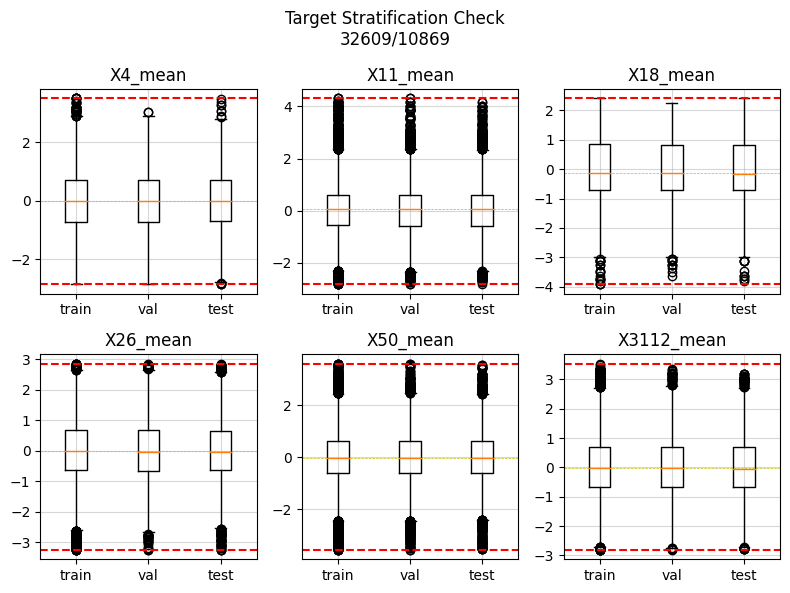

In [17]:
target_strat_check(targets, train_df, val_df, test_df, log_scaled=True)

**Raw Values below, Box-Cox transformed above**

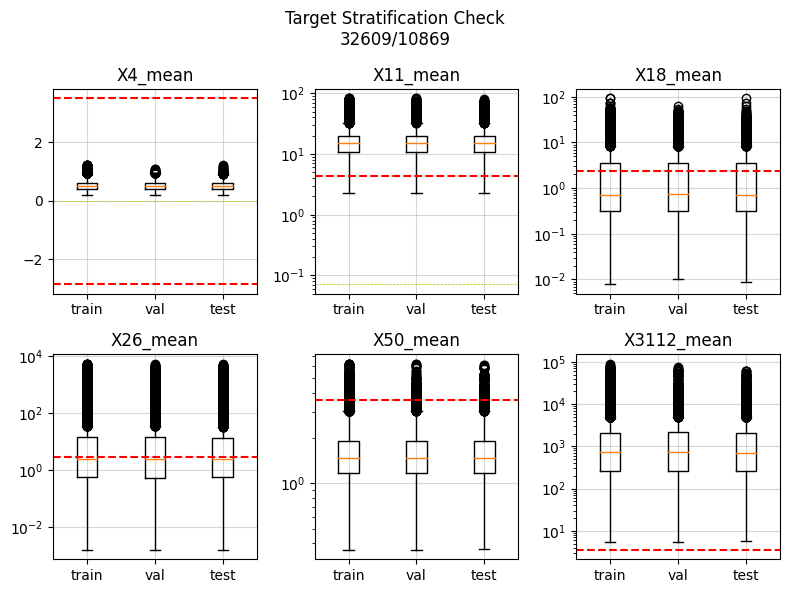

In [26]:
target_strat_check(targets, train_df,val_df, test_df, log_scaled=False,
                   inverse_transform=True, target_transformer=target_transform)

---
**Persist Testing Dataset for Residuals Analysis**

In [29]:
test_save = test_df.copy()
test_save[targets] = target_transform.inverse_transform(test_save[targets].values)
test_save.to_csv('test_set.csv')

---
### Modeling

In [86]:
# MobileNet/VGG | start 5e-3 | batch_size=256
initial_lr = 5e-3
def lr_scheduler(epoch, lr):
    if epoch < 3:
        return lr
    elif epoch < 7:
        return lr*0.8
    elif epoch < 10:
        return 2e-3
    else:
        return lr*0.8

my_callbacks = [
tf.keras.callbacks.LearningRateScheduler(lr_scheduler),    
tf.keras.callbacks.EarlyStopping(patience=5),
                ]

In [87]:
# __Ception | start 3e-3 | batch_size=64
initial_lr = 3e-3
def lr_scheduler(epoch, lr):
    if epoch < 4:
        return lr
    elif epoch < 8:
        return lr*0.8
    elif epoch < 11:
        return 1e-3
    else:
        return lr*0.8

In [20]:
# testing
# train_df = train_df.sample(1000)
# val_df = val_df.sample(200)
# test_df = test_df.sample(200)

In [88]:
gc.collect()

189883

	START
 Wed Jun  5 02:42:04 2024
	Preparing Validation Data
Found 10869 validated image filenames.
170 validation batches per epoch
	Preparing Training Data
Found 32609 validated image filenames.
510 training batches per epoch
	Preparing Evaluation data
Found 10869 validated image filenames.
170 eval batches per epoch
Epoch 1/15
510/510 [==============================] - 714s 1s/step - loss: 0.3190 - mean_absolute_error: 0.7024 - val_loss: 0.3165 - val_mean_absolute_error: 0.7124 - lr: 0.0030
Epoch 2/15
510/510 [==============================] - 482s 946ms/step - loss: 0.3084 - mean_absolute_error: 0.7015 - val_loss: 0.3153 - val_mean_absolute_error: 0.7114 - lr: 0.0030
Epoch 3/15
510/510 [==============================] - 479s 940ms/step - loss: 0.3042 - mean_absolute_error: 0.6950 - val_loss: 0.3099 - val_mean_absolute_error: 0.7026 - lr: 0.0030
Epoch 4/15
510/510 [==============================] - 486s 954ms/step - loss: 0.3003 - mean_absolute_error: 0.6890 - val_loss: 0.3054 - val_

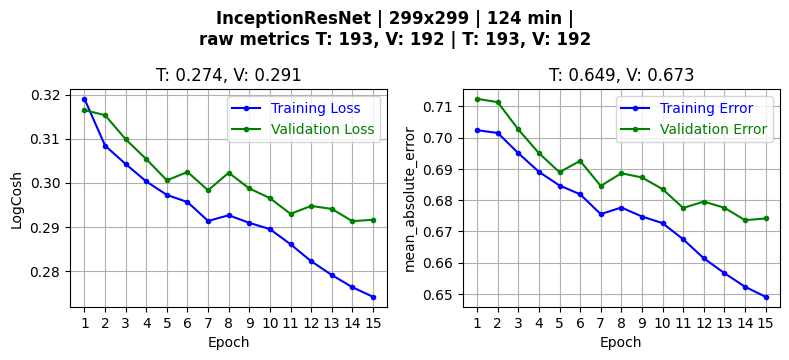

saved model: InceptionResNet
	-----	
129 total minutes for InceptionResNet

	STOP
 Wed Jun  5 04:52:22 2024
CPU times: user 2h 38min 53s, sys: 52min 5s, total: 3h 30min 59s
Wall time: 2h 10min 17s


In [89]:
%%time
print('\tSTART\n',asctime())

# parameters
# MobileNet: bs=256, im_dim=224x224
# IncResNet: bs=64, im_dim=299x299
mod_name = 'InceptionResNet'
fit_ep = 15
base_model = 'InceptionResNetV2'
bs=64 
im_dim = (299,299,3)
feature_dim = (21,)

# prepare datasets
train_ds, train_steps, val_ds, val_steps, eval_ds, eval_steps  \
= train_generators(train_df, val_df, test_df, bs=bs,)

# model
model = exarch_geo_combo(im_dim=im_dim, base_model=base_model, retrain=True,
                         feature_dim=feature_dim,)
gc.collect()

# fit
start = time()
fit_history = model.fit(train_ds,validation_data=val_ds, epochs=fit_ep, 
                        steps_per_epoch=train_steps, validation_steps=val_steps,
                        callbacks=my_callbacks, )
fit_time = f'{round((time()-start)/60)} min'

# get raw metrics
if target_transform:
    val_m, val_l = score(val_df, val_ds, val_steps, targets, target_transform)
    train_m, train_l = score(train_df, train_ds, train_steps, targets, target_transform)
    
    plot_title = f'{mod_name} | {im_dim[0]}x{im_dim[1]} | {fit_time} |\
\nraw metrics T: {round(train_l)}, V: {round(val_l)} | T: {round(train_m)}, V: {round(val_m)}'
else:
    plot_title = f'{mod_name} | {im_dim[0]}x{im_dim[1]} | {fit_time} |'


history_plot(fit_history, metric='mean_absolute_error', 
             title=plot_title, save_title=f'{mod_name}_{fit_ep}ep_history')
tf.keras.utils.plot_model(model, show_shapes=True, to_file=f'{mod_name}.png')
model.save(f'{mod_name}.keras')

print('saved model:', mod_name)
print('\t-----\t')
print(round((time()-start)/60), 'total minutes for', mod_name)
print('\n\tSTOP\n',asctime())

#### GeoData Only Performance?
 - not as good as combined model

In [22]:
X = pd.concat([train_df.iloc[:,:21], val_df.iloc[:,:21]])
y = pd.concat([train_df.loc[:,targets], val_df.loc[:,targets]])

In [11]:
cb_model = CatBoostRegressor(random_seed=42, verbose=False, loss_function='MultiRMSE', 
                             eval_metric='MultiRMSE',)

In [26]:
%%time
cv = cross_validate(cb_model, X, y, scoring='neg_mean_absolute_error')

CPU times: user 10min 7s, sys: 17.2 s, total: 10min 25s
Wall time: 2min 49s


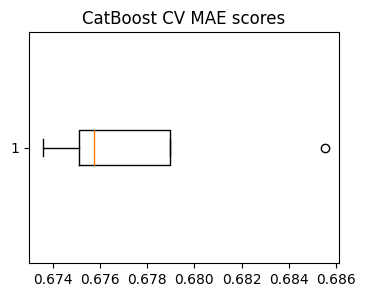

In [31]:
plt.figure(figsize=(4,3))
plt.boxplot(np.abs(cv['test_score']), vert=False)
plt.title('CatBoost CV MAE scores')
plt.show()

In [32]:
%%time

cb_model.fit(X,y)
cb_pred = cb_model.predict(test_df.iloc[:,:21])

CPU times: user 2min 19s, sys: 3.88 s, total: 2min 23s
Wall time: 39.8 s


In [45]:
met, loss = score_sklearn(test_df, cb_pred, targets, 
                          target_transform=target_transform)

In [46]:
met, loss

(263.2760184250611, 262.8231806488887)

#### Load Trained Model

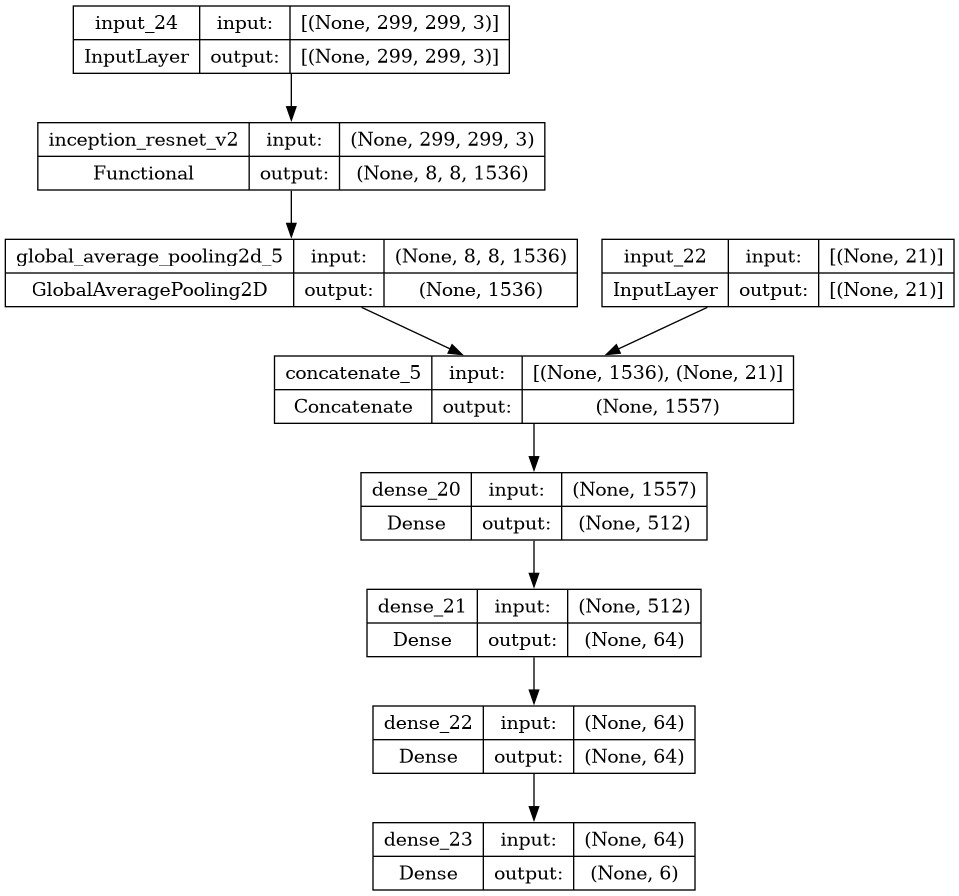

In [90]:
tf.keras.utils.plot_model(model, show_shapes=True, to_file=f'{mod_name}.png')

In [47]:
m_path = '/kaggle/working/MobileNet15ep.keras'
model = tf.keras.models.load_model(m_path)

### Save Test Predictions
 - hold out scores indicate model is not overfitting to a great degree, both for MobileNet and InceptionResNet
 - detailed residual analysis below

#### MobileNet
 - reran prediction cell without GPU acceleration, therefore time is high

In [52]:
%%time
pred = model.predict(x=eval_ds, steps=eval_steps)
pred = target_transform.inverse_transform(pred)

43/43 [==============================] - 678s 15s/step
CPU times: user 26min 15s, sys: 12min 42s, total: 38min 58s
Wall time: 11min 21s


In [53]:
met = mean_absolute_error(test_df[targets].values, pred)
met = tf.get_static_value(K.mean(met))
loss = log_cosh(test_df[targets].values, pred)
loss = tf.get_static_value(K.mean(loss))

print('\tevaluation dataset metrics\n', 
      'MAE:', round(met,1),'\tLogCosh', round(loss,1))

	evaluation dataset metrics
 MAE: 212.2 	LogCosh 211.6


In [100]:
pred_df = pd.DataFrame(pred, index=test_df.index, columns=targets)
pred_df.to_csv('MobileNet_predictions.csv')

#### InceptionResNet

In [91]:
%%time
pred = model.predict(x=eval_ds, steps=eval_steps)
pred = target_transform.inverse_transform(pred)

170/170 [==============================] - 64s 377ms/step
CPU times: user 1min 22s, sys: 25.2 s, total: 1min 47s
Wall time: 1min 5s


In [92]:
met = mean_absolute_error(test_df[targets].values, pred)
met = tf.get_static_value(K.mean(met))
loss = log_cosh(test_df[targets].values, pred)
loss = tf.get_static_value(K.mean(loss))

print('\tevaluation dataset metrics\n', 
      'MAE:', round(met,1),'\tLogCosh', round(loss,1))

print('\n\tsimilar to training metrics?', 
      '\nMAE:', round(train_m,1), '|', round(val_m,1),
      '\nLogCosh', round(train_l,1),'|', round(val_l,1),
     )

	evaluation dataset metrics
 MAE: 192.2 	LogCosh 191.6

	similar to training metrics? 
MAE: 193.5 | 192.4 
LogCosh 192.9 | 191.8


In [96]:
pred_df = pd.DataFrame(pred, index=test_df.index, columns=targets)
pred_df.to_csv('InceptionResNet_predictions.csv')

### Evaluate Residuals
 - reloading saved predictions, available on project repository. *training images not on repository*
   - [Test Set AKA `actual`](https://github.com/NBPub/Springboard/blob/main/Capstone%20Three/model_files/test_set.csv) | [MobileNet predictions `p1`](https://github.com/NBPub/Springboard/blob/main/Capstone%20Three/model_files/MobileNet_predictions.csv) | [InceptionResNet predictions `p2`](https://github.com/NBPub/Springboard/blob/main/Capstone%20Three/model_files/InceptionResNet_predictions.csv) |
   - competition data: [kaggle](https://www.kaggle.com/competitions/planttraits2024/data)
     - target descriptions `target_name_meta.csv`

In [97]:
descriptions = {}

for i,description in enumerate(['Stem/wood density','Leaf area per mass',
                                'Plant Height', 'Seed dry mass',
                                'Leaf nitrogen per area', 'Leaf area']):
    descriptions[targets[i]] = description

In [59]:

p1 = pd.read_csv('/kaggle/working/MobileNet_predictions.csv', index_col=0)
p2 = pd.read_csv('/kaggle/working/InceptionResNet_predictions.csv', index_col=0)

actual = pd.read_csv('/kaggle/working/test_set.csv', index_col=0)
actual = actual.loc[:, targets]

In [68]:
# must run GeoData only cells for "cb_pred"
# p3 = target_transform.inverse_transform(cb_pred)
# p3 = pd.DataFrame(p3, p1.index, p1.columns)

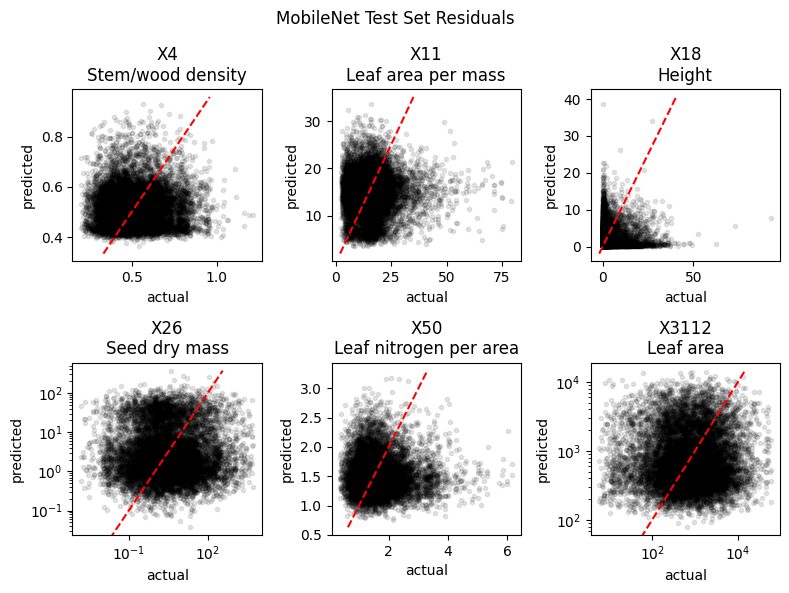

In [64]:
plt.figure(figsize=(8,6), tight_layout=True)

for i,col in enumerate(targets):
    ax = plt.subplot(2,3,i+1)
    ax.plot(actual[col], p1[col], 'k.', alpha=0.1)
    yb = ax.get_ylim()
    plt.plot(yb, yb, 'r--')
    if actual[col].max() > 1000:
        ax.set_yscale('log')
        ax.set_xscale('log')
    ax.set_ylabel('predicted')
    ax.set_xlabel('actual')
    ax.set_title(f"{col.split('_')[0]}\n{descriptions[col]}")
    #ax.set_ylim(yb)

    
plt.suptitle('MobileNet Test Set Residuals')
plt.savefig('MobileNet_residuals.png')
plt.show()

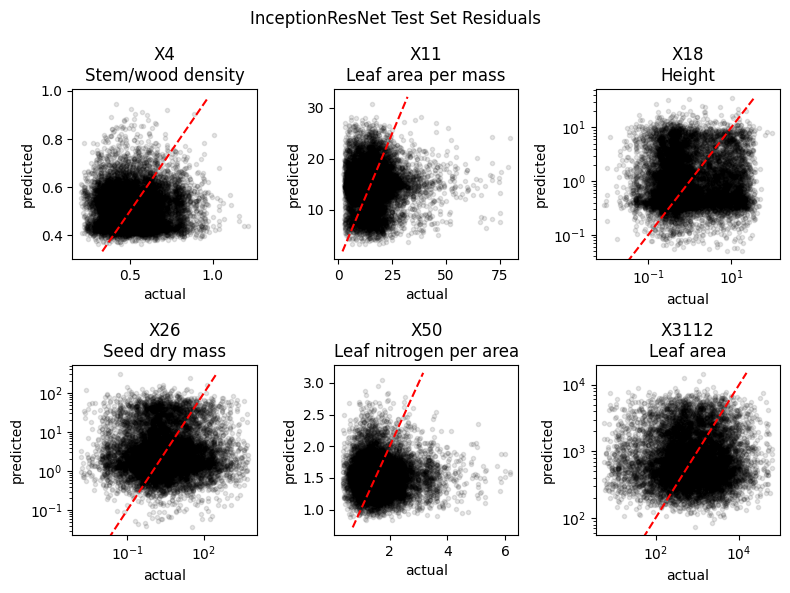

In [65]:
plt.figure(figsize=(8,6), tight_layout=True)

for i,col in enumerate(targets):
    ax = plt.subplot(2,3,i+1)
    ax.plot(actual[col], p2[col], 'k.', alpha=0.1)
    yb = ax.get_ylim()
    plt.plot(yb, yb, 'r--')
    if actual[col].max() > 1000 or col=='X18_mean':
        ax.set_yscale('log')
        ax.set_xscale('log')
    ax.set_ylabel('predicted')
    ax.set_xlabel('actual')
    ax.set_title(f"{col.split('_')[0]}\n{descriptions[col]}")

    
plt.suptitle('InceptionResNet Test Set Residuals')
plt.savefig('InceptionResNet_residuals.png')
plt.show()

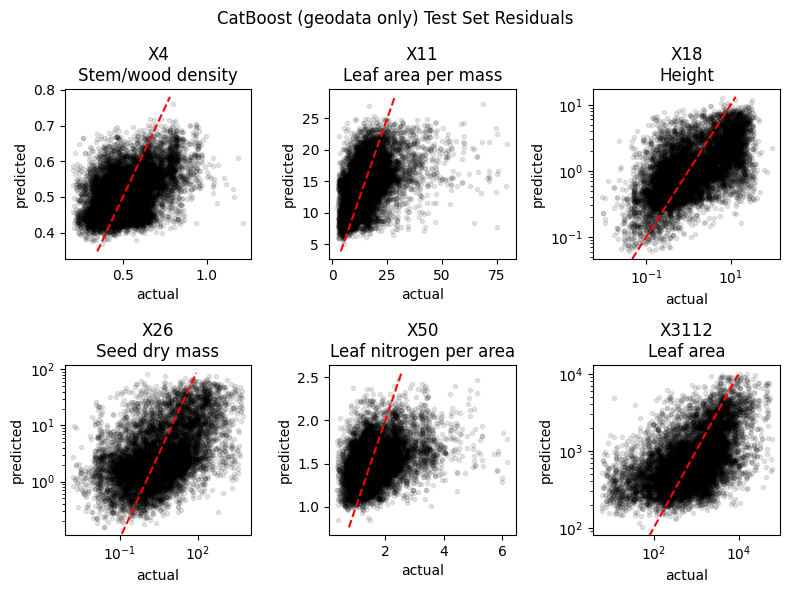

In [70]:
plt.figure(figsize=(8,6), tight_layout=True)

for i,col in enumerate(targets):
    ax = plt.subplot(2,3,i+1)
    ax.plot(actual[col], p3[col], 'k.', alpha=0.1)
    yb = ax.get_ylim()
    plt.plot(yb, yb, 'r--')
    if actual[col].max() > 1000 or col=='X18_mean':
        ax.set_yscale('log')
        ax.set_xscale('log')
    ax.set_ylabel('predicted')
    ax.set_xlabel('actual')
    ax.set_title(f"{col.split('_')[0]}\n{descriptions[col]}")

    
plt.suptitle('CatBoost (geodata only) Test Set Residuals')
plt.savefig('CatBoost_residuals.png')
plt.show()

---
*Images with Residuals for each trait and model, saved graphs in repository*

In [93]:
def plant_plotter(actual, pred, y, descriptions, worst=True,
                  save_title=None,):
    
    
    image_folder = '/kaggle/input/planttraits2024/train_images'
    
    if worst:
        error = (actual[y]-pred[y]).sort_values()
        indices = pd.concat([error.head(4), error.tail(4)])
    else:
        error = (actual[y]-pred[y]).abs().sort_values()
        indices = error.head(8)
    
    num_cols = 4
    num_rows = (len(indices) - 1) // num_cols + 1    
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 8))
   
    for i, ind in enumerate(indices.index):
        img = Image.open(Path(image_folder, f'{ind}.jpeg'))
        ax = axs[i // num_cols, i % num_cols]
        ax.imshow(img)
        ax.axis('off')

        ax.set_title(f"ID: {ind} | error: {indices[ind]:.2f}\nactual {actual.loc[ind,y]:.2f} | pred {pred.loc[ind,y]:.2f}")
        
        for j in range(len(indices), num_rows*num_cols):
            axs.flatten()[j].set_visible(False)
    
    
    
    plt.suptitle(f'{descriptions[y]} {"greatest" if worst else "lowest"} residuals', 
                 y=0.96, fontsize='large', fontweight='bold')
    plt.tight_layout()
    if save_title and save_title!='':
        plt.savefig(f'{save_title}_{y.split("_")[0]}.png', dpi=100)
    plt.show()

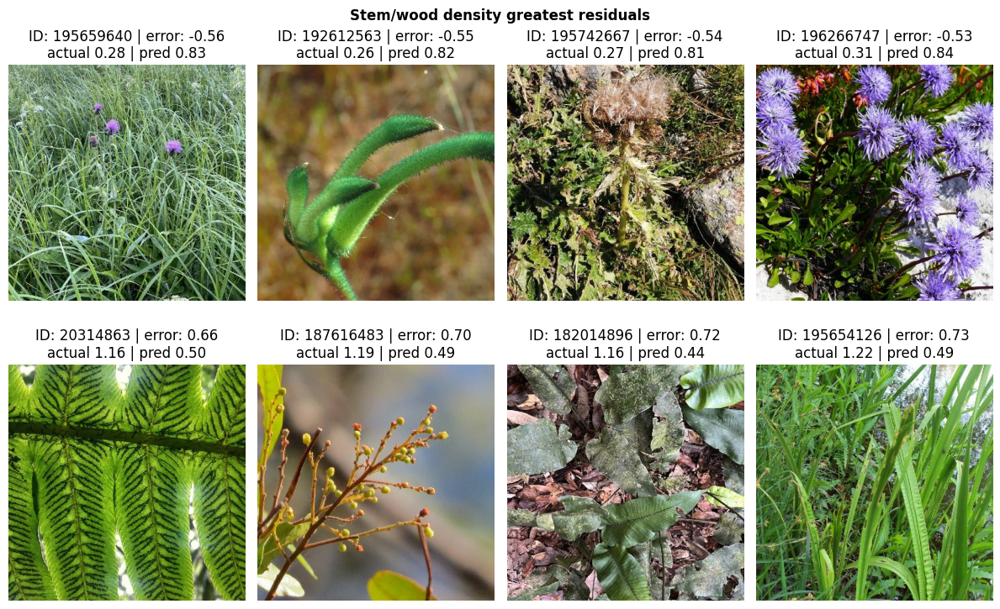

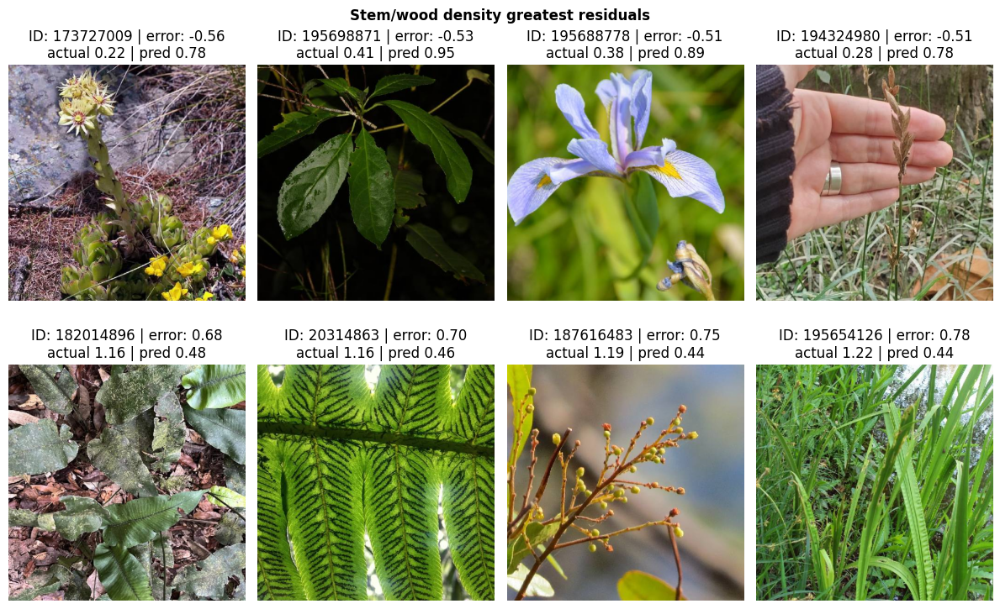

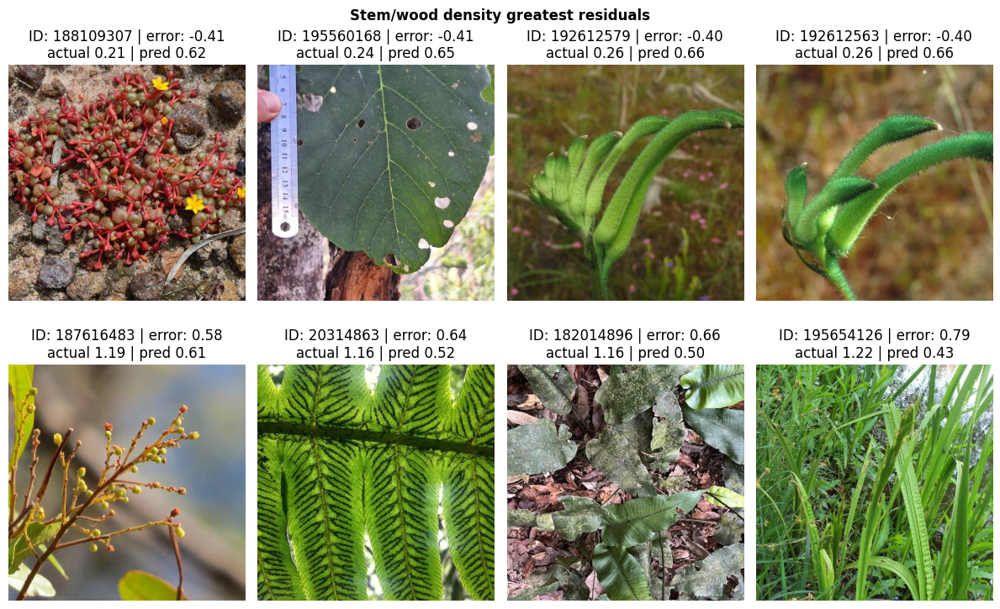

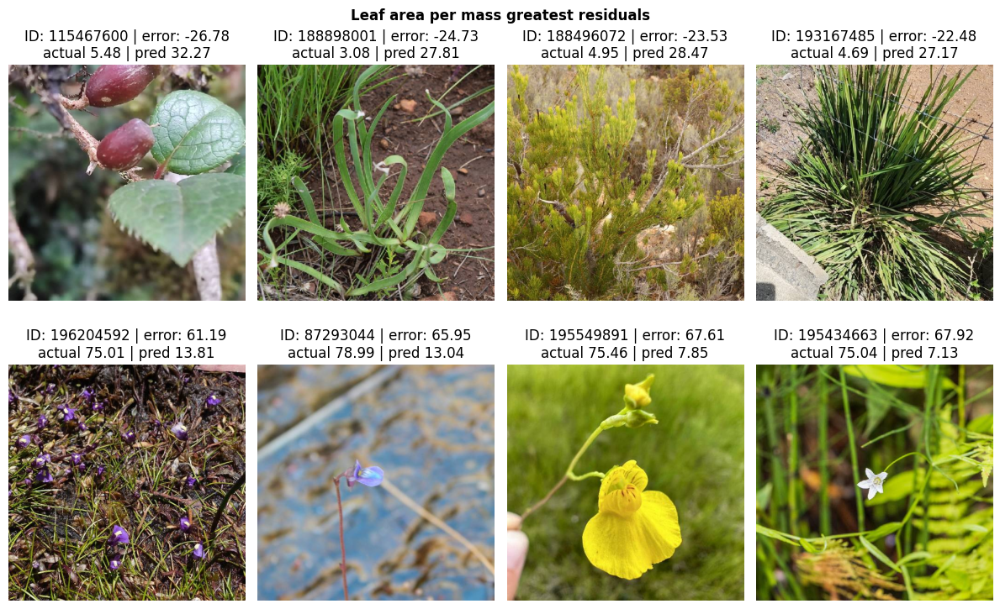

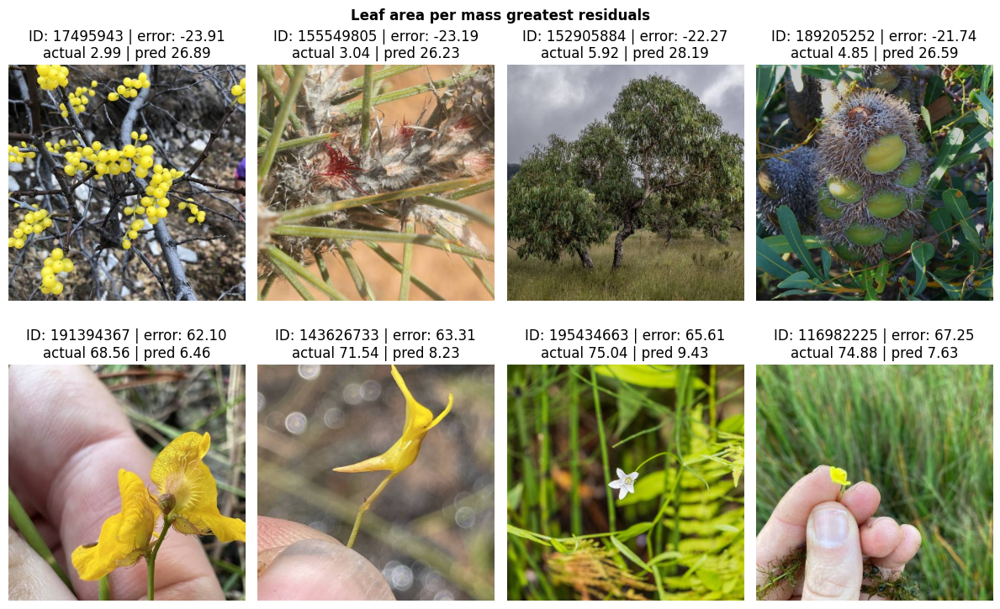

...

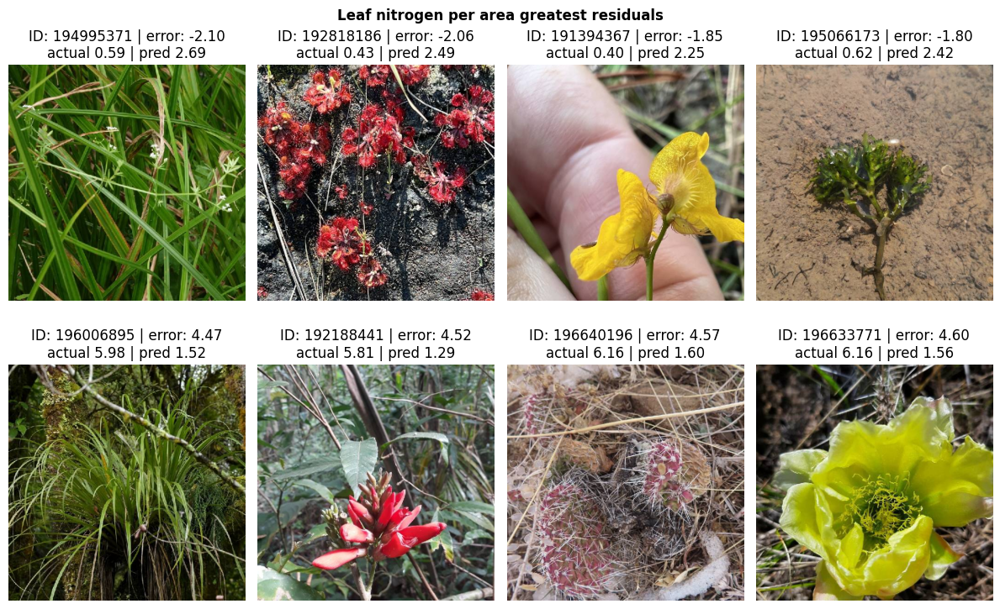

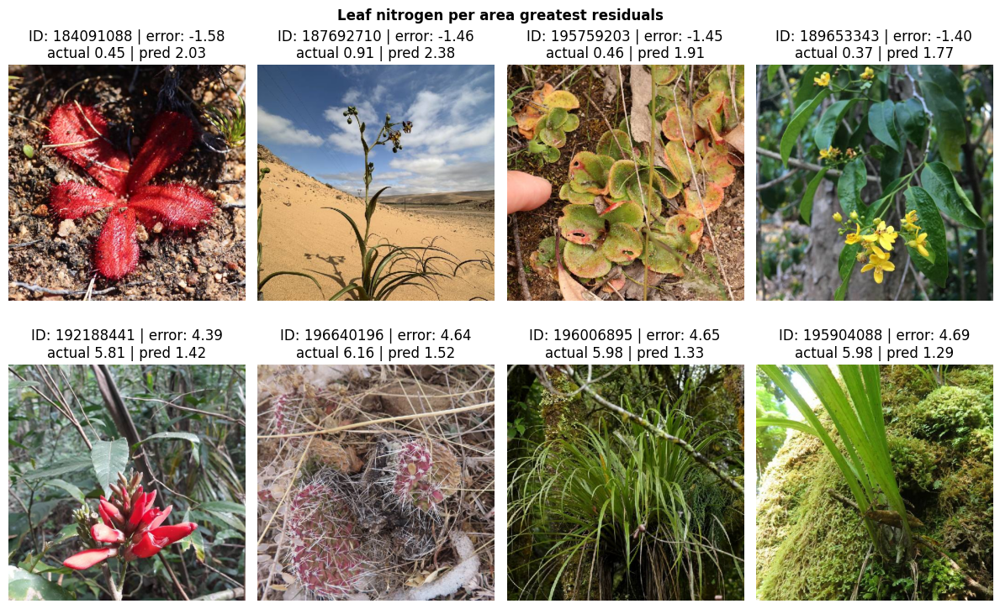

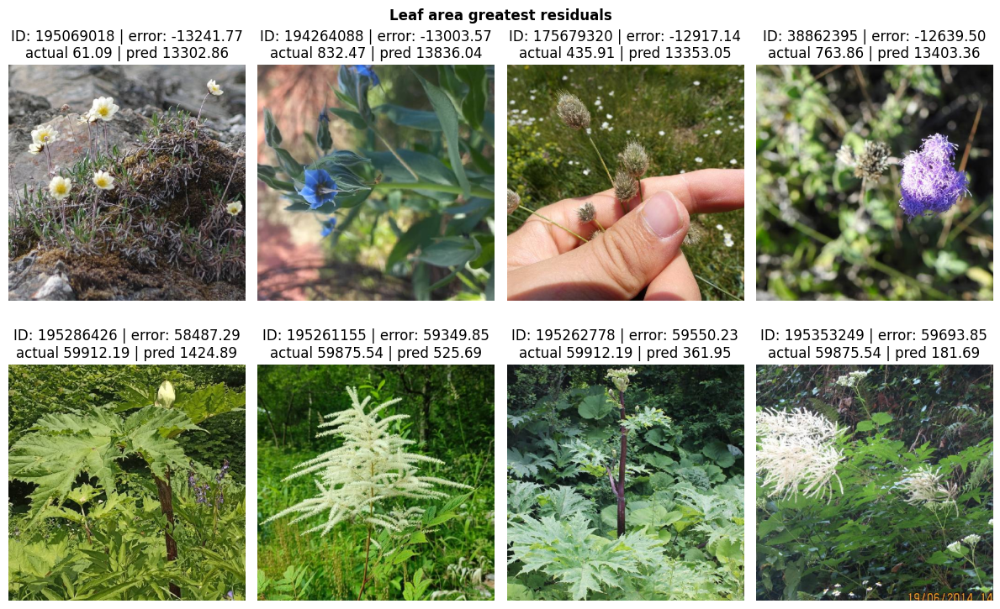

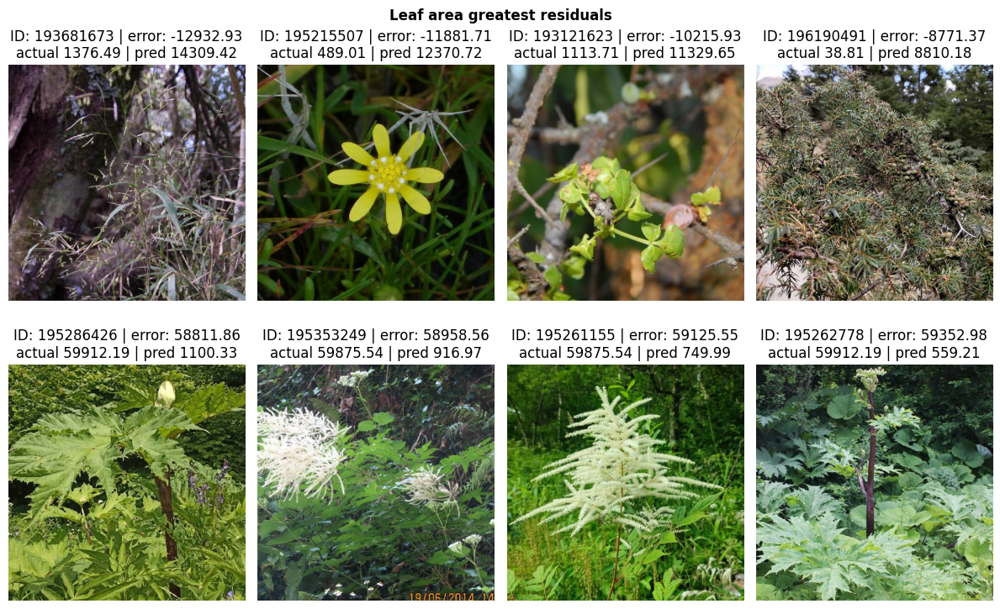

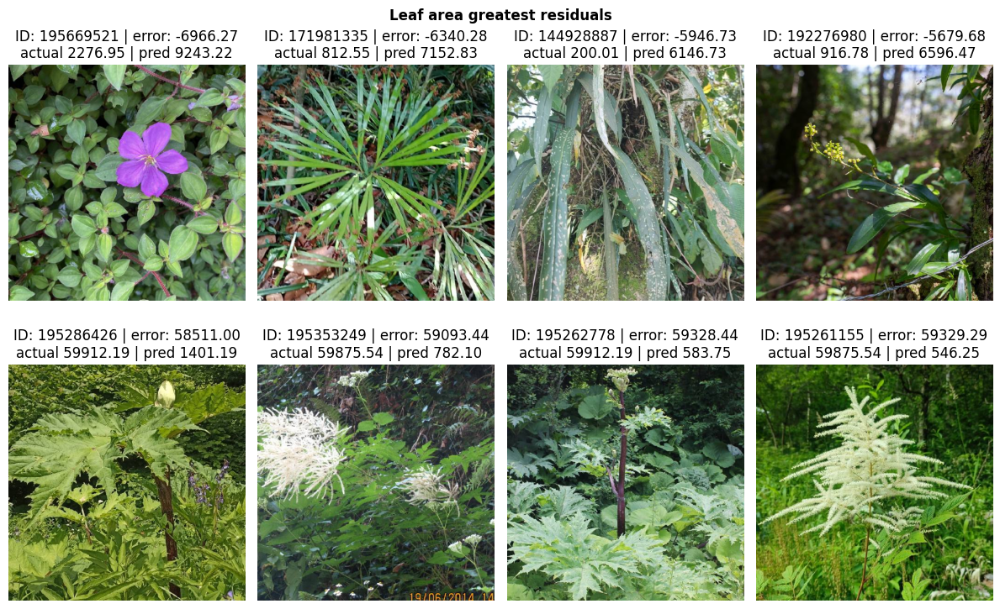

In [101]:
for t in targets:
    for name, mod in {'MobileNet':p1,
                      'InceptionResNet': p2,
                      'CatBoost (geodata only)': p3
                     }.items():
        plant_plotter(actual, mod, t, descriptions, 
                      save_title=f'{name}_resid')


In [ ]:
# best predictions for given model/target
# targets[5] = leaf area, biggest range of any target
plant_plotter(actual, p1, targets[5], descriptions, worst=False)